# Files for Streamlit app

This notebook will create plots and json files for the Streamlit. You can download similar files from [here](https://drive.google.com/file/d/1kCGUZY6ZG9asS1vIIKR88OTFa-RSZueZ/view?usp=sharing).

## Libraries

Let's load the libraries for this notebook.
- **Tensorflow dataset** to load the dataset
- **Librosa** and **Matplotlib** to create plots 
- **Soundfile** to save wav files

In [1]:
import tensorflow_datasets as tfds

import librosa
import librosa.display
import soundfile as sf

import numpy as np
import matplotlib
import matplotlib.pyplot as plt

import json

import os
import pathlib

import warnings
warnings.filterwarnings('ignore')

In [2]:
print(f"Tensorflow datasets: {tfds.__version__}")
print(f"Numpy: {np.__version__}")
print(f"Matplotlib: {matplotlib.__version__}")
print(f"Librosa: {librosa.__version__}")
print(f"Soundfile: {sf.__version__}")

Tensorflow datasets: 4.2.0
Numpy: 1.19.5
Matplotlib: 3.4.1
Librosa: 0.8.0
Soundfile: 0.10.3


## Dataset

Let's load the two splits: train and test.

In [3]:
import pump
data_dir = "../dataset"

(train, test), info = tfds.load(
    "pump",
    split=["train", "test"],
    data_dir=data_dir,
    with_info=True,
)

## Folders preparation

Let's create the folders that will keep the files for the Streamlit app. We need the following folders:
- **store** to have the other three folders
- **audios** to keep wav files
- **images** to keep librosa plots
- **json** to keep json files from the audios files

We also need to create a **test** and **train** folder for the folder audios, images and json.

Altogether, we need ten folders.

In [4]:
path_store = os.path.join("..", "..", "..", "production", "frontend", "store")
path = pathlib.Path(path_store)
if not path.exists():
    os.mkdir(path_store)

In [5]:
path_audios = os.path.join("..", "..", "..", "production", "frontend", "store", "audios")
path = pathlib.Path(path_audios)
if not path.exists():
    os.mkdir(path_audios)

path_audios_test = os.path.join(path_audios, "test")
path = pathlib.Path(path_audios_test)
if not path.exists():
    os.mkdir(path_audios_test)

path_audios_train = os.path.join(path_audios, "train")
path = pathlib.Path(path_audios_train)
if not path.exists():
    os.mkdir(path_audios_train)

In [6]:
path_images = os.path.join("..", "..", "..", "production", "frontend", "store", "images")
path = pathlib.Path(path_images)
if not path.exists():
    os.mkdir(path_images)

path_images_test = os.path.join(path_images, "test")
path = pathlib.Path(path_images_test)
if not path.exists():
    os.mkdir(path_images_test)

path_images_train = os.path.join(path_images, "train")
path = pathlib.Path(path_images_train)
if not path.exists():
    os.mkdir(path_images_train)

In [7]:
path_json = os.path.join("..", "..", "..", "production", "frontend", "store", "json")
path = pathlib.Path(path_json)
if not path.exists():
    os.mkdir(path_json)

path_json_test = os.path.join(path_json, "test")
path = pathlib.Path(path_json_test)
if not path.exists():
    os.mkdir(path_json_test)

path_json_train = os.path.join(path_json, "train")
path = pathlib.Path(path_json_train)
if not path.exists():
    os.mkdir(path_json_train)

## Files creation

Streamlit app needs:
- wav files to let users listen to the audio
- librosa plots to show audio features to understand better the audio
- json files to request Tensorflow server a prediction

Let's get audios randomly from the train and test and save them as wav files, create the librosa plots and convert them into json files.

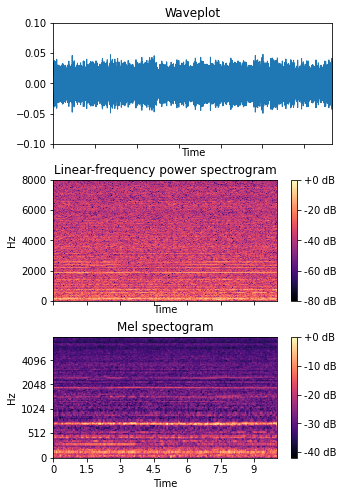

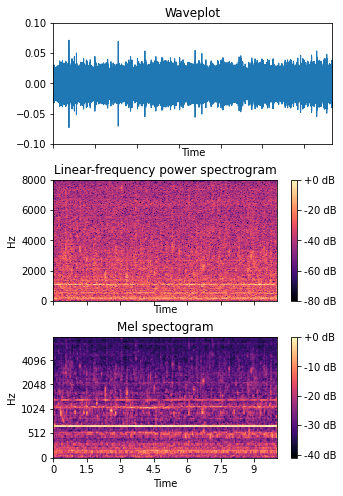

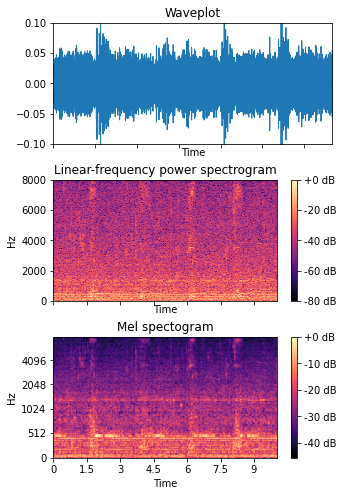

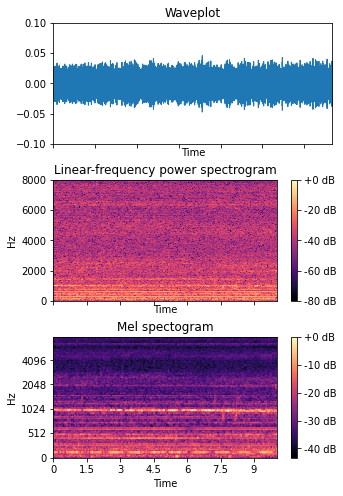

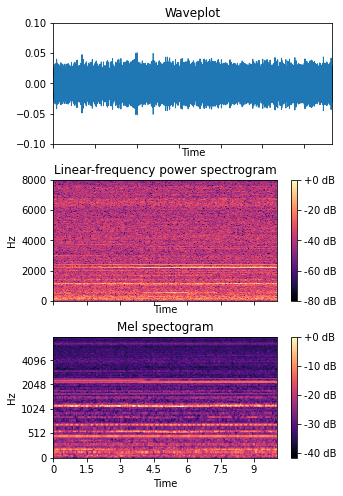

...

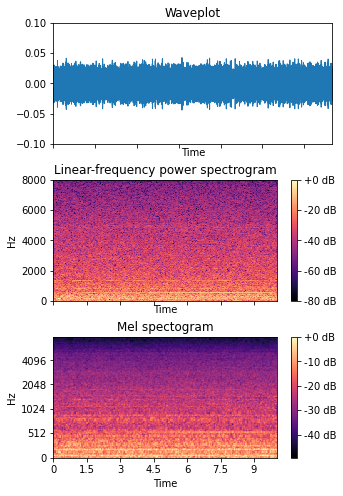

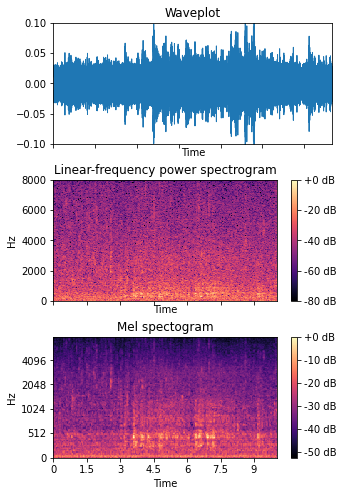

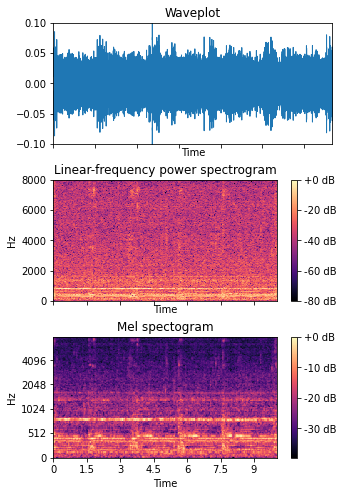

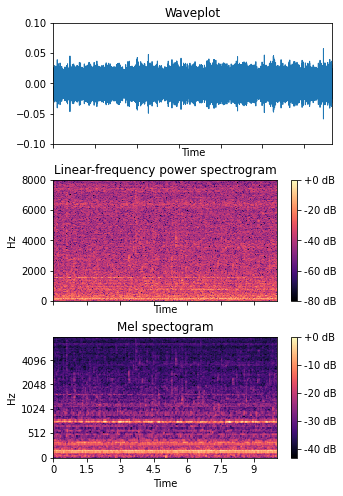

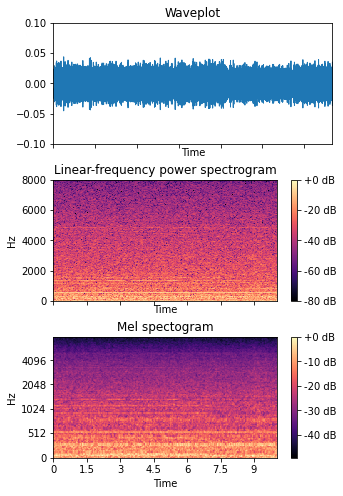

In [8]:
sr = info.features["audio"].sample_rate

for item in tfds.as_numpy(test.shuffle(2048).take(32)):
    label = ["normal", "anomaly"][item["label"]]
    machine_id = item["audio/machine"].decode('utf-8')
    audio_id = item["audio/id"].decode('utf-8')

    fname=f"{label}_id_{machine_id}_0000{audio_id}"

    y = item["audio"] / 2**15
    sr = 16_000

    # Save audio file
    path_fname = os.path.join(path_audios_test, f"{fname}.wav")
    sf.write(path_fname, y, sr)

    # Save Matplotlib plot
    fig, ax = plt.subplots(3, 1, figsize=(5, 8), sharex = True)
    fig.subplots_adjust(hspace=0.3)

    librosa.display.waveplot(y, sr=sr, ax=ax[0])
    ax[0].set(ylim=(-0.1, 0.1))
    ax[0].set(title=f"Waveplot")

    S = np.abs(librosa.stft(y))
    D = librosa.amplitude_to_db(S, ref=np.max)
    img = librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr, ax=ax[1])
    ax[1].set(title=f"Linear-frequency power spectrogram")
    fig.colorbar(img, ax=ax[1], format='%+2.0f dB')

    S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128, fmax=8000)
    S_dB = librosa.power_to_db(S, ref=np.max)
    img = librosa.display.specshow(S_dB, x_axis='time', y_axis='mel', sr=sr, fmax=8000, ax=ax[2])
    ax[2].set(title=f"Mel spectogram")
    fig.colorbar(img, ax=ax[2], format='%+2.0f dB')

    path_fname = os.path.join(path_images_test, f"{fname}.png")
    plt.savefig(path_fname)

    # Save Json file
    test_audios = []
    test_audios.append(item["audio"].tolist())

    data = json.dumps({"signature_name": "serving_default", "instances": test_audios})
    
    path_fname = os.path.join(path_json_test, f"{fname}.json")
    with open(path_fname, "w") as json_file:
        json_file.write(data)

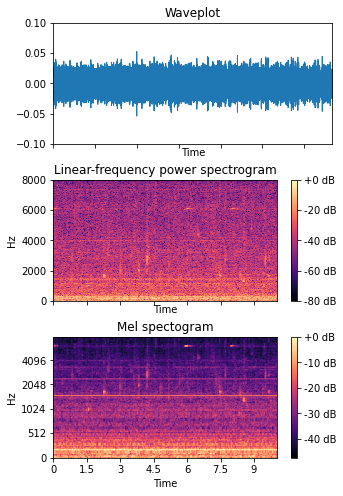

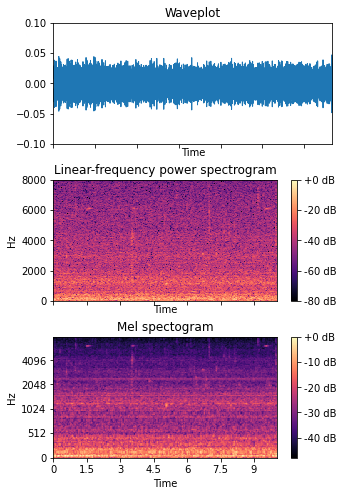

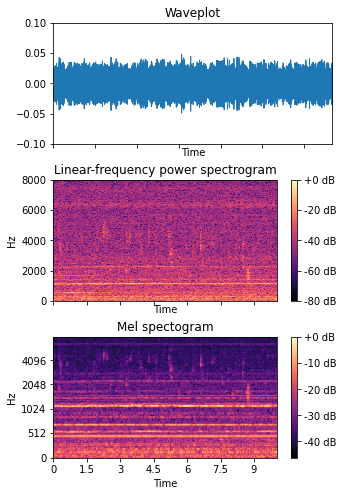

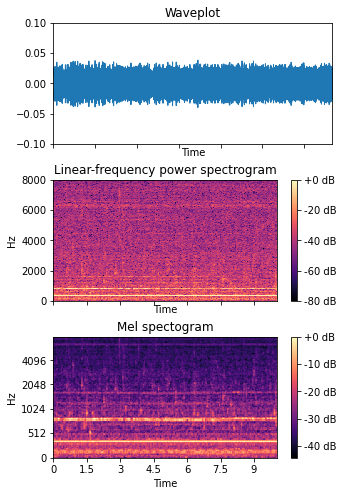

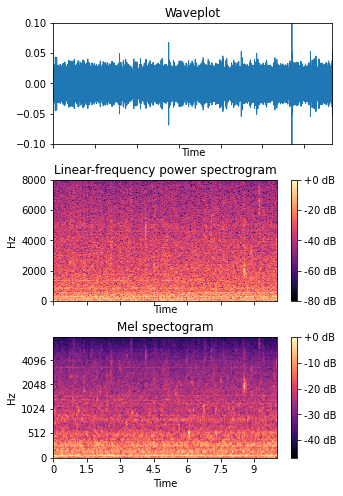

...

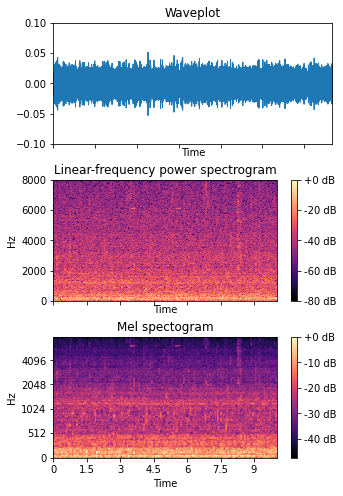

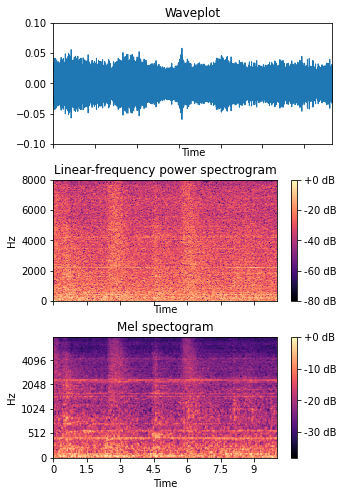

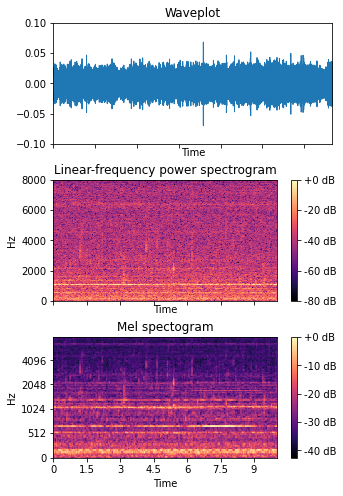

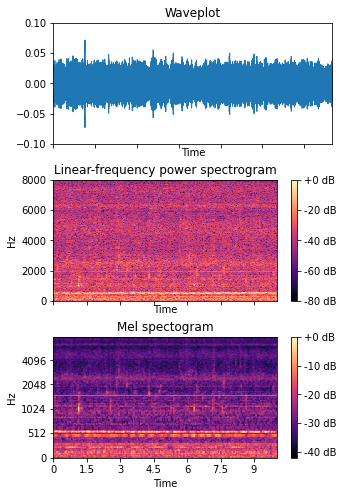

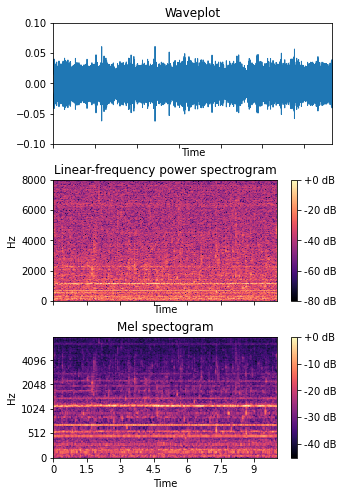

In [9]:
for item in tfds.as_numpy(train.shuffle(2048).take(100)):
    label = ["normal", "anomaly"][item["label"]]
    machine_id = item["audio/machine"].decode('utf-8')
    audio_id = item["audio/id"].decode('utf-8')

    fname=f"{label}_id_{machine_id}_0000{audio_id}"

    y = item["audio"] / 2**15
    sr = 16_000

    # Save audio file
    path_fname = os.path.join(path_audios_train, f"{fname}.wav")
    sf.write(path_fname, y, sr)

    # Save Matplotlib plot
    fig, ax = plt.subplots(3, 1, figsize=(5, 8), sharex = True)
    fig.subplots_adjust(hspace=0.3)

    librosa.display.waveplot(y, sr=sr, ax=ax[0])
    ax[0].set(ylim=(-0.1, 0.1))
    ax[0].set(title=f"Waveplot")

    S = np.abs(librosa.stft(y))
    D = librosa.amplitude_to_db(S, ref=np.max)
    img = librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr, ax=ax[1])
    ax[1].set(title=f"Linear-frequency power spectrogram")
    fig.colorbar(img, ax=ax[1], format='%+2.0f dB')

    S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128, fmax=8000)
    S_dB = librosa.power_to_db(S, ref=np.max)
    img = librosa.display.specshow(S_dB, x_axis='time', y_axis='mel', sr=sr, fmax=8000, ax=ax[2])
    ax[2].set(title=f"Mel spectogram")
    fig.colorbar(img, ax=ax[2], format='%+2.0f dB')

    path_fname = os.path.join(path_images_train, f"{fname}.png")
    plt.savefig(path_fname)

    # Save Json file
    test_audios = []
    test_audios.append(item["audio"].tolist())

    data = json.dumps({"signature_name": "serving_default", "instances": test_audios})
    
    path_fname = os.path.join(path_json_train, f"{fname}.json")
    with open(path_fname, "w") as json_file:
        json_file.write(data)